In [ ]:
import os
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader, random_split
import torchvision
from torchvision import models
import torch.nn.functional as F
import albumentations as A
from albumentations.pytorch import ToTensorV2
from PIL import Image
from tqdm.notebook import tqdm

import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
plt.rcParams['figure.dpi'] = 150
%config InlineBackend.figure_format = 'retina'

In [ ]:
'''! pip install torchinfo
! pip install torch_lr_finder
! pip install torchmetrics
from google.colab import drive
import zipfile
import os
import shutil
final_dir = '/content/data'

# Mount Google Drive
drive.mount('/content/drive')

# Define paths to the zip files in Google Drive and local directories
zip_file_1 = '/content/drive/MyDrive/DvXray_Positive_Samples.zip'
zip_file_2 = '/content/drive/MyDrive/DvXray_Negative_Samples.zip'
unzip_dir_1 = '/content/data'
unzip_dir_2 = '/content/data'


# Create directories to unzip the files into if they don't exist
os.makedirs(unzip_dir_1, exist_ok=True)
os.makedirs(unzip_dir_2, exist_ok=True)
os.makedirs(final_dir, exist_ok=True)

# Unzip files
with zipfile.ZipFile(zip_file_1, 'r') as zip_ref:
    zip_ref.extractall(unzip_dir_1)
with zipfile.ZipFile(zip_file_2, 'r') as zip_ref:
    zip_ref.extractall(unzip_dir_2)

# Combine the contents of the two folders into one folder
def merge_folders(src, dst):
    for filename in os.listdir(src):
        src_path = os.path.join(src, filename)
        dst_path = os.path.join(dst, filename)
        if os.path.isfile(src_path):
            shutil.copy(src_path, dst_path)
        elif os.path.isdir(src_path):
            merge_folders(src_path, dst_path)


# Execute merging
merge_folders('data/DvXray_Positive_Samples', final_dir)
merge_folders('data/DvXray_Negative_Samples', final_dir)

print("Files merged successfully into:", final_dir)
'''

'! pip install torchinfo\n! pip install torch_lr_finder\n! pip install torchmetrics\nfrom google.colab import drive\nimport zipfile\nimport os\nimport shutil\nfinal_dir = \'/content/data\'\n\n# Mount Google Drive\ndrive.mount(\'/content/drive\')\n\n# Define paths to the zip files in Google Drive and local directories\nzip_file_1 = \'/content/drive/MyDrive/DvXray_Positive_Samples.zip\'\nzip_file_2 = \'/content/drive/MyDrive/DvXray_Negative_Samples.zip\'\nunzip_dir_1 = \'/content/data\'\nunzip_dir_2 = \'/content/data\'\n\n\n# Create directories to unzip the files into if they don\'t exist\nos.makedirs(unzip_dir_1, exist_ok=True)\nos.makedirs(unzip_dir_2, exist_ok=True)\nos.makedirs(final_dir, exist_ok=True)\n\n# Unzip files\nwith zipfile.ZipFile(zip_file_1, \'r\') as zip_ref:\n    zip_ref.extractall(unzip_dir_1)\nwith zipfile.ZipFile(zip_file_2, \'r\') as zip_ref:\n    zip_ref.extractall(unzip_dir_2)\n\n# Combine the contents of the two folders into one folder\ndef merge_folders(src, dst

# Dual-view Baggage Inspection Task
Data from: https://github.com/Mbwslib/DvXray/tree/main

Data and paper citation:

```
@ARTICLE{10458082,
  author={Ma, Bowen and Jia, Tong and Li, Mingyuan and Wu, Songsheng and Wang, Hao and Chen, Dongyue},
  journal={IEEE Transactions on Information Forensics and Security},
  title={Toward Dual-View X-Ray Baggage Inspection: A Large-Scale Benchmark and Adaptive Hierarchical Cross Refinement for Prohibited Item Discovery},
  year={2024},
  volume={19},
  number={},
  pages={3866-3878},
  keywords={X-ray imaging;Task analysis;Security;Feature extraction;Training;Inspection;Benchmark testing;Prohibited item discovery;dual-view X-ray dataset;baggage screening;classification;localization},
  doi={10.1109/TIFS.2024.3372797}}
```


Data attributes:
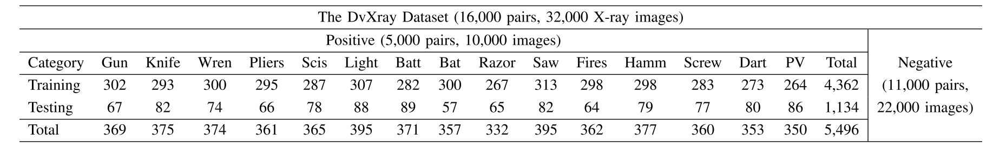

This is a multi-label classification problem, that is one image (pair) may have more than one label (prohibited items), and those prohibited items are not mutually exclusive.

The database of security checks dual-view X-ray images have the following characteristics:
- 3 channels (RGB) of each view
- 600x800 pixels
- 2 views: orthogonal and side
- overlapping items in the images, and the items may be rotated
- Some items can be only seen in one view, or partially seen in both views

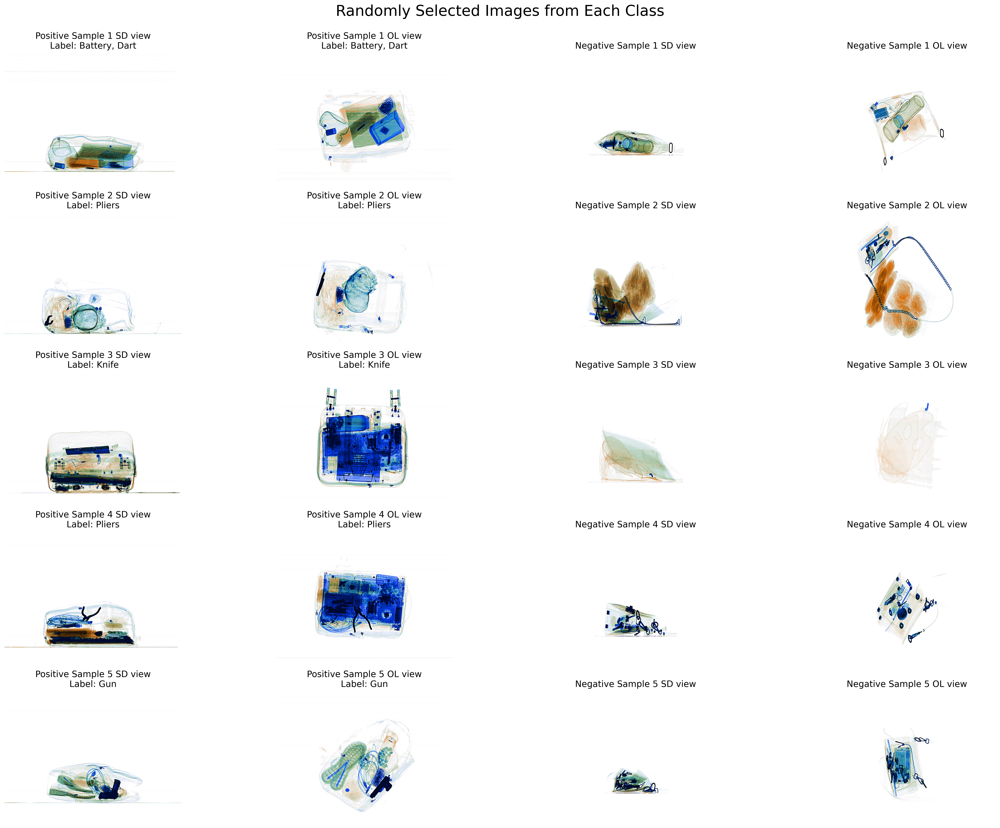

In [ ]:
data_path = '/content/data'
data_list = os.listdir(data_path)
# randomly select 5 images from each class, each image has two angles, they start with the P or N
# label them if their json file has a object key and a label key,
# the json file will have same name as the image name before the _ in the name
data_list = os.listdir(data_path)
pos_idx = [f for f in data_list if f.startswith('P') and f.endswith('_SD.png')]
neg_idx = [f for f in data_list if f.startswith('N') and f.endswith('_SD.png')]
pos_idx = [f.split('_')[0] for f in pos_idx]
neg_idx = [f.split('_')[0] for f in neg_idx]

pos_idx = np.random.choice(pos_idx, 5, replace=False)
neg_idx = np.random.choice(neg_idx, 5, replace=False)

fig, axs = plt.subplots(5, 4, figsize=(25, 20),dpi=150)
fig.suptitle('Randomly Selected Images from Each Class', fontsize=24, y=0.92)

# Plot positive samples
for i, idx in enumerate(pos_idx):
    img1 = Image.open(os.path.join(data_path, idx + '_SD.png'))
    img2 = Image.open(os.path.join(data_path, idx + '_OL.png'))
    json_file = os.path.join(data_path, idx + '.json')
    with open(json_file, 'r') as f:
        data = json.load(f)
    labels = []
    if data['objects'] is not None:
        for obj in data.get('objects', []):
            labels.append(obj['label'])
    axs[i, 0].set_title(f'Positive Sample {i+1} SD view\nLabel: {", ".join(labels)}', fontsize=14)
    axs[i, 1].set_title(f'Positive Sample {i+1} OL view\nLabel: {", ".join(labels)}', fontsize=14)
    axs[i, 0].imshow(img1)
    axs[i, 0].axis('off')
    axs[i, 1].imshow(img2)
    axs[i, 1].axis('off')

# Plot negative samples
for i, idx in enumerate(neg_idx):
    img1 = Image.open(os.path.join(data_path, idx + '_SD.png'))
    img2 = Image.open(os.path.join(data_path, idx + '_OL.png'))
    json_file = os.path.join(data_path, idx + '.json')
    axs[i, 2].imshow(img1)
    axs[i, 2].axis('off')
    axs[i, 2].set_title(f'Negative Sample {i+1} SD view', fontsize=14)
    axs[i, 3].imshow(img2)
    axs[i, 3].axis('off')
    axs[i, 3].set_title(f'Negative Sample {i+1} OL view', fontsize=14)

# Adjust layout
plt.subplots_adjust(top=0.88)
plt.tight_layout(rect=[0, 0, 1, 0.92])
plt.show()

Dataloader: read the unstructured files, and make labels, to decrease the use of GPU RAM, we resize the input images of each view to 450*600 (original 600 * 800, it runs out of GPU memory even if we use A100 GPU). Data augmentation were innitially considererd but abandoned eventually, as it required too much GPU RAM ~39GB. And we test Augmentation at a samll data set and find not that useful, likely due to the Dual-View Xray are too overlapped and compliacted, also prohibited items sometimes can be very small (e.g. lighter)

We could find the labels are not 100% correct, e.g. for sample 3, there is only one label 'Knife', however, there are something very similary to batteries.

In [ ]:
# Prohibited items list
prohibited_items = ['Gun', 'Knife', 'Wrench', 'Pliers', 'Scissors', 'Lighter', 'Battery', 'Bat', 'Razor_blade', 'Saw_blade', 'Fireworks', 'Hammer', 'Screwdriver', 'Dart', 'Pressure_vessel']

# Create a mapping from item to index for multi-label classification
item_to_idx = {item: idx for idx, item in enumerate(prohibited_items)}


# Define a common normalization function
common_normalization = A.Compose([
    A.Normalize(mean=(0.91584104, 0.9297611, 0.939562), std=(0.22090791, 0.1861283, 0.1651021), p=1.0),
    ToTensorV2()
])

# Define additional augmentations for training
train_augmentations = A.Compose([
    A.CropAndPad(4, keep_size=False, pad_mode=2),
    A.RandomCrop(32, 32),
    A.HorizontalFlip(p=0.5),
    A.CoarseDropout(1, 8, 8, p=1.0)  # Cutout
], p=1.0)

# Apply transforms (with optional augmentations) to both OL and SD images
def apply_transforms(image_ol, image_sd, augmentations=None):
    if augmentations:
        image_ol = augmentations(image=image_ol)["image"]
        image_sd = augmentations(image=image_sd)["image"]

    # Normalize both images with the same normalization function
    image_ol = common_normalization(image=image_ol)["image"]
    image_sd = common_normalization(image=image_sd)["image"]

    # Concatenate both angles to form a 6-channel image
    return torch.cat([image_ol, image_sd], dim=0)

# Define the custom dataset class
class DvXray(Dataset):
    def __init__(self, data_dir, augmentations=None):
        self.data_dir = data_dir
        self.augmentations = augmentations
        self.image_pairs = []
        self.labels = []

        # Load all image pairs and corresponding labels
        for filename in os.listdir(self.data_dir):
            if filename.endswith('_SD.png'):
                base_name = filename.split('_')[0]
                ol_image = os.path.join(self.data_dir, f"{base_name}_OL.png")
                sd_image = os.path.join(self.data_dir, f"{base_name}_SD.png")
                json_file = os.path.join(self.data_dir, f"{base_name}.json")

                if os.path.exists(ol_image) and os.path.exists(sd_image) and os.path.exists(json_file):
                    try:
                        with open(json_file, 'r') as f:
                            label_data = json.load(f)
                            label_vector = [0] * len(prohibited_items)
                            for obj in label_data.get('objects', []):
                                if isinstance(obj, dict) and 'label' in obj and obj['label'] in item_to_idx:
                                    label_vector[item_to_idx[obj['label']]] = 1
                            self.image_pairs.append((ol_image, sd_image))
                            self.labels.append(label_vector)
                    except (json.JSONDecodeError, TypeError):
                        print(f"Warning: Could not decode JSON file {json_file} or it's malformed.")

    def __len__(self):
        return len(self.image_pairs)

    def __getitem__(self, index):
        ol_image_path, sd_image_path = self.image_pairs[index]
        label = self.labels[index]

        ol_image = Image.open(ol_image_path).convert("RGB").resize((600, 450))
        sd_image = Image.open(sd_image_path).convert("RGB").resize((600, 450))

        ol_array = np.array(ol_image)
        sd_array = np.array(sd_image)

        combined_image = apply_transforms(ol_array, sd_array, augmentations=self.augmentations)

        return combined_image, torch.tensor(label, dtype=torch.float32)

# Custom collate function to handle multi-label targets
def collate_fn(batch):
    images, labels = zip(*batch)
    images = torch.stack(images)
    labels = torch.stack(labels)
    return images, labels

# Set data directory
data_dir = data_path

# Initialize the full dataset
full_dataset = DvXray(data_dir, augmentations=None)

# Define the train-validation split ratio
train_val_ratio = 0.8
train_size = int(train_val_ratio * len(full_dataset))
val_size = len(full_dataset) - train_size


# Split the toy dataset into training and validation sets
train_dataset, valid_dataset = random_split(full_dataset, [train_size, val_size])

# Batch size
batch_size = 32
# Initialize data loaders
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn, num_workers=4)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn, num_workers=4)

# Test the dataset
for batch_images, batch_labels in train_loader:
    print(f"Images batch shape: {batch_images.shape}")
    print(f"Labels batch shape: {batch_labels.shape}")
    break

#batch_labels


Images batch shape: torch.Size([32, 6, 450, 600])
Labels batch shape: torch.Size([32, 15])


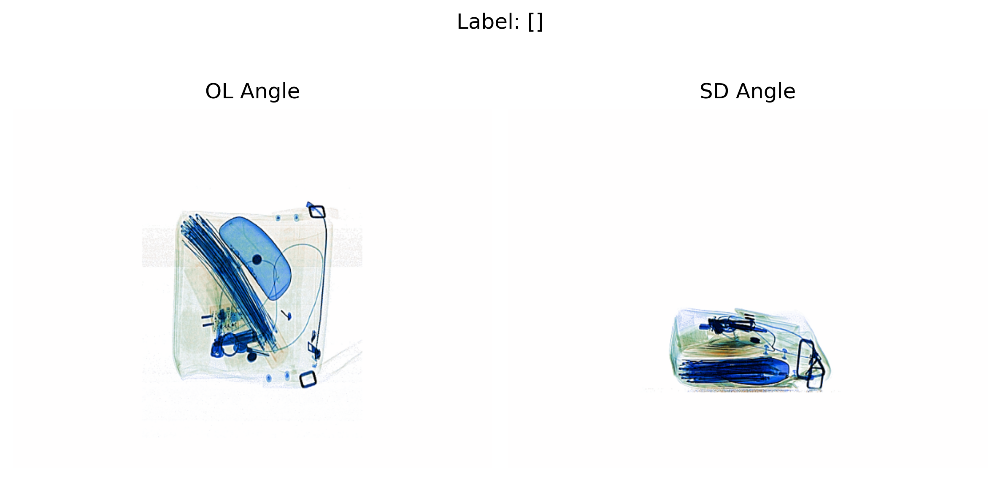

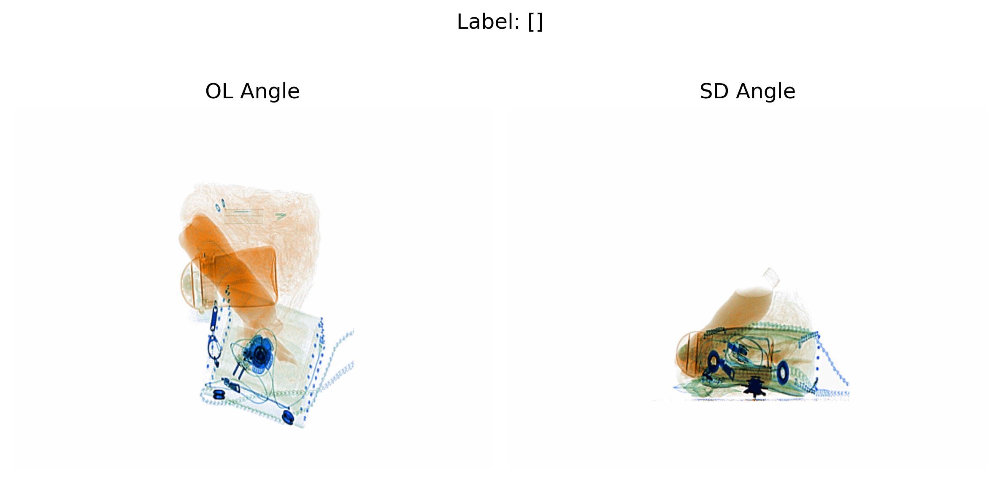

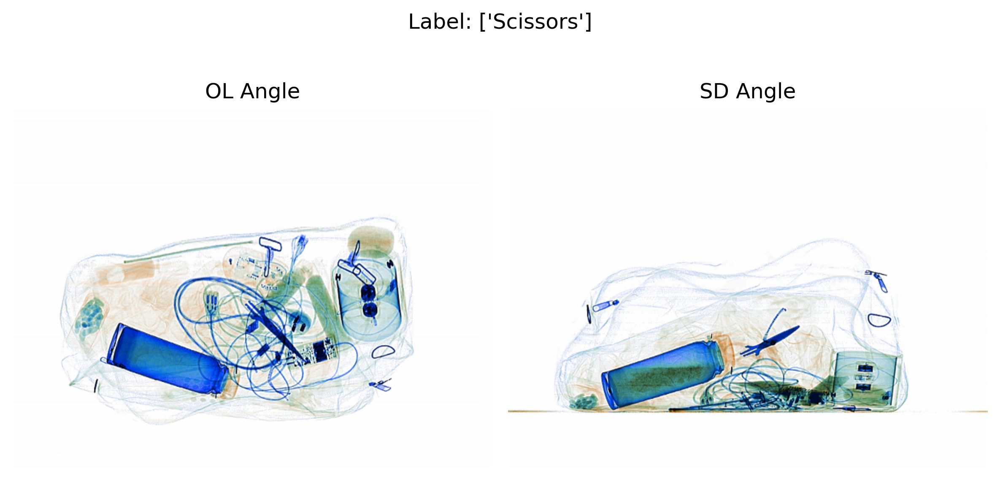

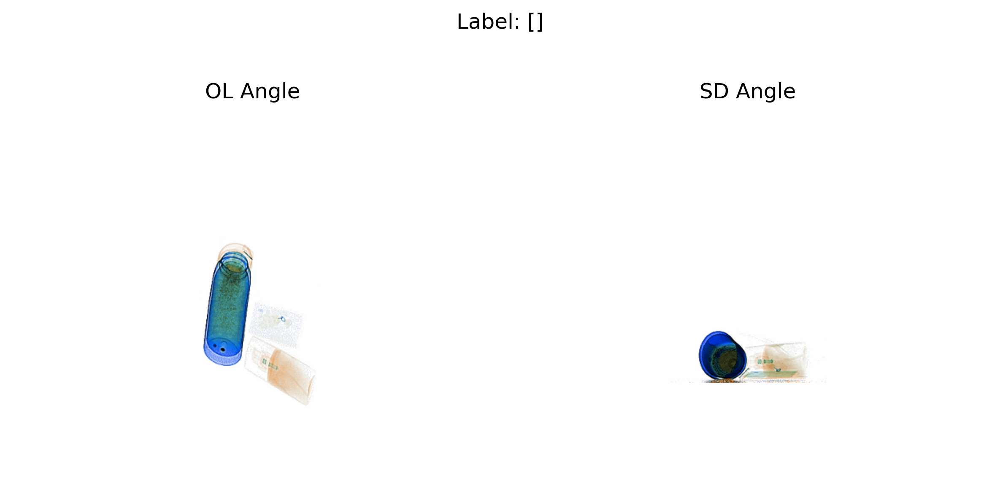

In [ ]:
# decode label vector into prohibited item names
def decode_labels(label_vector, prohibited_items):
    return [prohibited_items[idx] for idx, value in enumerate(label_vector) if value == 1]

# Reverse normalization for a single 3-channel image
def reverse_normalization(img):
    mean = np.array([0.91584104, 0.9297611, 0.939562])
    std = np.array([0.22090791, 0.1861283, 0.1651021])
    img = img * std + mean
    img = np.clip(img, 0, 1)
    return img

def show_image(image, label):
    # Convert tensor to numpy array
    img = image.numpy()

    ol_img = np.transpose(img[:3], (1, 2, 0))  # First 3 channels ol-view
    sd_img = np.transpose(img[3:], (1, 2, 0))  # Last 3 channels sd-view

    # Reverse normalization
    ol_img = reverse_normalization(ol_img)
    sd_img = reverse_normalization(sd_img)

    # Decode labels
    decoded_label = decode_labels(label, prohibited_items)

    fig, axs = plt.subplots(1, 2, figsize=(8, 4))

    axs[0].imshow(ol_img)
    axs[0].axis("off")
    axs[0].set_title("OL Angle")

    axs[1].imshow(sd_img)
    axs[1].axis("off")
    axs[1].set_title("SD Angle")

    fig.suptitle(f"Label: {decoded_label}")
    plt.subplots_adjust(wspace=-0.5)
    plt.tight_layout()
    plt.show()


# first 4 pairs of pictures in train loader
for images, labels in train_loader:
    for i in range(4):
        show_image(images[i], labels[i].numpy())
    break


# Methodology

## Network Architecture

The proposed network architecture is based on the ResNet50 backbone, which is modified to accept 6-channel input images, consisting of RGB channels for each of the two views (overlaid and side). The output of the network is a 1*15 tensor, representing the predicted probabilities for each of the 15 classes in the multi-label classification task.

### Input and Splitting

Let $\mathbf{x} \in \mathbb{R}^{B \times 6 \times H \times W}$ denote the input image, where $B$ is the batch size, $6$ represents the number of channels (3 for each view), and $H$ and $W$ are the height and width of the image, respectively. The input is split into two views: overlaid view $\mathbf{x}_{ol} \in \mathbb{R}^{B \times 3 \times H \times W}$ and side-by-side view $\mathbf{x}_{sd} \in \mathbb{R}^{B \times 3 \times H \times W}$.

### Feature Extraction

A shared ResNet50 feature extractor $f(\cdot)$ is used to extract features from both views: $f(\mathbf{x}_{ol}), f(\mathbf{x}_{sd}) \in \mathbb{R}^{B \times 2048 \times 1 \times 1}$. By concatenating the two views along the batch dimension and passing them through the shared feature extractor, the model can reduce the number of parameters and promote information exchange between the views.

### Top Layer

The shared top layer $g(\cdot)$ further processes the extracted features: $g(f(\mathbf{x}_{ol})), g(f(\mathbf{x}_{sd})) \in \mathbb{R}^{B \times 2048}$. This results in two feature tensors, $\mathbf{u}_{ol}$ and $\mathbf{u}_{sd}$, where the subscripts 'ol' and 'sd' are used for naming convenience and do not imply that these feature tensors only contain information from a single view. The top layer typically includes 1x1 convolution, batch normalization, ReLU activation, and adaptive average pooling operations.

### Cosine Similarity

The cosine similarity between the two feature tensors $\mathbf{u}_{ol}, \mathbf{u}_{sd} \in \mathbb{R}^{B \times 2048}$ is computed as:

$$
\mathbf{s} = \frac{\mathbf{u}_{ol} \cdot \mathbf{u}_{sd}}{\|\mathbf{u}_{ol}\| \|\mathbf{u}_{sd}\|} \in \mathbb{R}^{B}
$$

The cosine similarity measures the similarity between the two feature tensors and helps the model capture the relationship between the views, facilitating information fusion.

### Feature Fusion

The two feature tensors are fused based on the cosine similarity using a weighted sum:

$$
\mathbf{v} = (\mathbf{u}_{ol} + \mathbf{u}_{sd}) \odot \mathbf{s} \in \mathbb{R}^{B \times 2048}
$$

where $\odot$ denotes element-wise multiplication. Feature fusion allows the model to adaptively adjust the importance of each feature dimension based on the similarity between the views, enabling better integration of information from both views.

### Classifier and Prediction

The fused feature tensor $\mathbf{v}$ is passed through a classifier $h(\cdot)$ for multi-label prediction:

$$
\mathbf{p} = h(\mathbf{v}) \in \mathbb{R}^{B \times C}
$$

where $C$ is the number of classes (15 in this case). The sigmoid activation function is used to map the predictions to the $[0, 1]$ interval, representing the probability of each class.

## Rationale for Shared Backbone and Top Layer

Sharing the ResNet50 backbone and the top layer between the two views offers several advantages:

1. **Parameter Efficiency**: By using a shared backbone and top layer, the model can significantly reduce the number of parameters compared to using separate networks for each view. This parameter efficiency is particularly beneficial when dealing with limited training data or computational resources.

2. **Information Exchange**: Sharing the backbone and top layer allows for implicit information exchange between the two views. The shared layers can learn to extract features that are relevant to both views, facilitating the fusion of information at a later stage.

3. **Consistent Feature Representation**: Using a shared backbone ensures that the features extracted from both views are in the same feature space. This consistency is important for the subsequent cosine similarity computation and feature fusion steps, as it allows for meaningful comparison and integration of features from different views.

## Rationale for Splitting and Concatenating Views

The decision to split the input into two views and concatenate them along the batch dimension before passing them through the shared backbone is motivated by the following reasons:

1. **Batch Processing**: By concatenating the views along the batch dimension, the model can process both views simultaneously in a single forward pass. This is computationally more efficient than processing each view separately and allows for parallel computation.

2. **Feature Extraction**: The shared backbone can extract features from both views in a single pass, reducing redundant computations. The extracted features  are then split into separate tensors for further processing in the top layer.

3. **Maintaining View-Specific Information**: Splitting the features after feature extraction allows the model to maintain view-specific information while still benefiting from the shared backbone. The top layer can then process the features from each view separately, enabling the model to capture view-specific patterns and relationships.

4. **Facilitating Feature Fusion**: By splitting the features after feature extraction, the model can compute the cosine similarity between the feature tensors. This similarity measure is then used to fuse the features adaptively, giving more importance to features that are consistent across views.

In summary, the proposed network architecture leverages a shared ResNet50 backbone and top layer to efficiently extract features from both views while promoting information exchange. The input is split into two views and concatenated along the batch dimension to enable batch processing and maintain view-specific information. The cosine similarity between the view-specific feature tensors is used to adaptively fuse the features, allowing the model to effectively integrate information from both views for improved multi-label classification performance.

In [ ]:
from torchmetrics import AveragePrecision
from IPython.display import clear_output, display
from IPython.display import HTML
import time

class DualViewResNet(nn.Module):
    def __init__(self, num_classes=15):
        super(DualViewResNet, self).__init__()
        base_model = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1, progress=False)
        self.features = nn.Sequential(*list(base_model.children())[:-2])
        self.top_layer = nn.Sequential(
            nn.Conv2d(2048, 2048, kernel_size=1),
            nn.BatchNorm2d(2048),
            nn.ReLU(),
            nn.AdaptiveAvgPool2d(1)
        )
        self.classifier = nn.Linear(2048, num_classes)

    def forward(self, x):
        x_ol, x_sd = x[:, :3, :, :], x[:, 3:, :, :]
        features = self.features(torch.cat((x_ol, x_sd), dim=0))
        features_ol, features_sd = features.chunk(2, dim=0)
        out_ol = self.top_layer(features_ol).view(features_ol.size(0), -1)
        out_sd = self.top_layer(features_sd).view(features_sd.size(0), -1)

        # Compute cosine similarity between the features from both views
        similarity = torch.cosine_similarity(out_ol, out_sd, dim=1, eps=1e-8)

        # Fuse the features based on the similarity
        fused_features = (out_ol + out_sd) * similarity.view(-1, 1)

        # Make predictions using the fused features
        pred = self.classifier(fused_features)

        return pred

class BCELoss(nn.Module):
    def __init__(self):
        super(BCELoss, self).__init__()
        self.bce_loss = nn.BCEWithLogitsLoss()

    def forward(self, outputs, targets):
        return self.bce_loss(outputs, targets)

def evaluate(model, loader, device, loss_fn):
    model.eval()
    ap = AveragePrecision(num_labels=15, task='multilabel')
    total_loss = 0.0
    with torch.no_grad():
        for data, targets in loader:
            data, targets = data.to(device), targets.to(device).float()
            fused_output = model(data)
            loss = loss_fn(fused_output, targets)
            total_loss += loss.item() * data.size(0)
            ap.update(fused_output, targets.int())
    avg_loss = total_loss / len(loader.dataset)
    avg_ap = ap.compute().mean().item()  # Mean AP across classes
    return avg_loss, avg_ap

def train(model, train_loader, valid_loader, lr, loss_fn, num_epochs, device, checkpoint_dir='checkpoints'):
    table = pd.DataFrame(columns=['Epoch', 'Train Loss', 'Valid Loss', 'Train AP', 'Valid AP', 'Time'])
    optimizer = torch.optim.Adam(model.parameters(), lr = lr)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)

    # Create checkpoint directory
    os.makedirs(checkpoint_dir, exist_ok=True)

    # Check if a checkpoint exists
    checkpoint_path = os.path.join(checkpoint_dir, 'checkpoint.pt')
    if os.path.exists(checkpoint_path):
        # Load the checkpoint
        checkpoint = torch.load(checkpoint_path)
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
        start_epoch = checkpoint['epoch'] + 1
        table = checkpoint['table']
    else:
        start_epoch = 0

    model.to(device)
    for epoch in range(start_epoch, num_epochs):
        model.train()
        total_loss = 0
        epoch_start = time.time()

        ap = AveragePrecision(num_labels=15, task='multilabel')

        for data, targets in train_loader:
            data = data.to(device)
            targets = targets.to(device).float()

            optimizer.zero_grad()
            outputs = model(data)
            loss = loss_fn(outputs, targets)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            total_loss += loss.item() * data.size(0)
            # Update AP calculation
            ap.update(outputs, targets.int())

        avg_loss = total_loss / len(train_loader.dataset)
        avg_ap = ap.compute().mean().item()  # Compute final AP
        valid_loss, valid_ap = evaluate(model, valid_loader, device, loss_fn)

        epoch_time = time.time() - epoch_start
        epoch_time = time.strftime('%H:%M:%S', time.gmtime(epoch_time)) if epoch_time > 3600 else time.strftime('%M:%S', time.gmtime(epoch_time))

        # Append current epoch data to the table
        table = pd.concat([table, pd.DataFrame([[epoch + 1, avg_loss, valid_loss, avg_ap, valid_ap, epoch_time]], columns=table.columns)], ignore_index=True)

        clear_output(wait=True)
        display(HTML(table.to_html(index=False)))

        # Save the checkpoint
        torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
            'table': table
        }, checkpoint_path)

    return model, table

In [ ]:
from torchinfo import summary
model = DualViewResNet()
summary(model, input_size=(1, 6, 450, 600))

Layer (type:depth-idx)                        Output Shape              Param #
DualViewResNet                                [1, 15]                   --
├─Sequential: 1-1                             [2, 2048, 15, 19]         --
│    └─Conv2d: 2-1                            [2, 64, 225, 300]         9,408
│    └─BatchNorm2d: 2-2                       [2, 64, 225, 300]         128
│    └─ReLU: 2-3                              [2, 64, 225, 300]         --
│    └─MaxPool2d: 2-4                         [2, 64, 113, 150]         --
│    └─Sequential: 2-5                        [2, 256, 113, 150]        --
│    │    └─Bottleneck: 3-1                   [2, 256, 113, 150]        75,008
│    │    └─Bottleneck: 3-2                   [2, 256, 113, 150]        70,400
│    │    └─Bottleneck: 3-3                   [2, 256, 113, 150]        70,400
│    └─Sequential: 2-6                        [2, 512, 57, 75]          --
│    │    └─Bottleneck: 3-4                   [2, 512, 57, 75]          379,392

  0%|          | 0/100 [00:00<?, ?it/s]

Learning rate search finished. See the graph with {finder_name}.plot()
LR suggestion: steepest gradient
Suggested LR: 1.52E-04


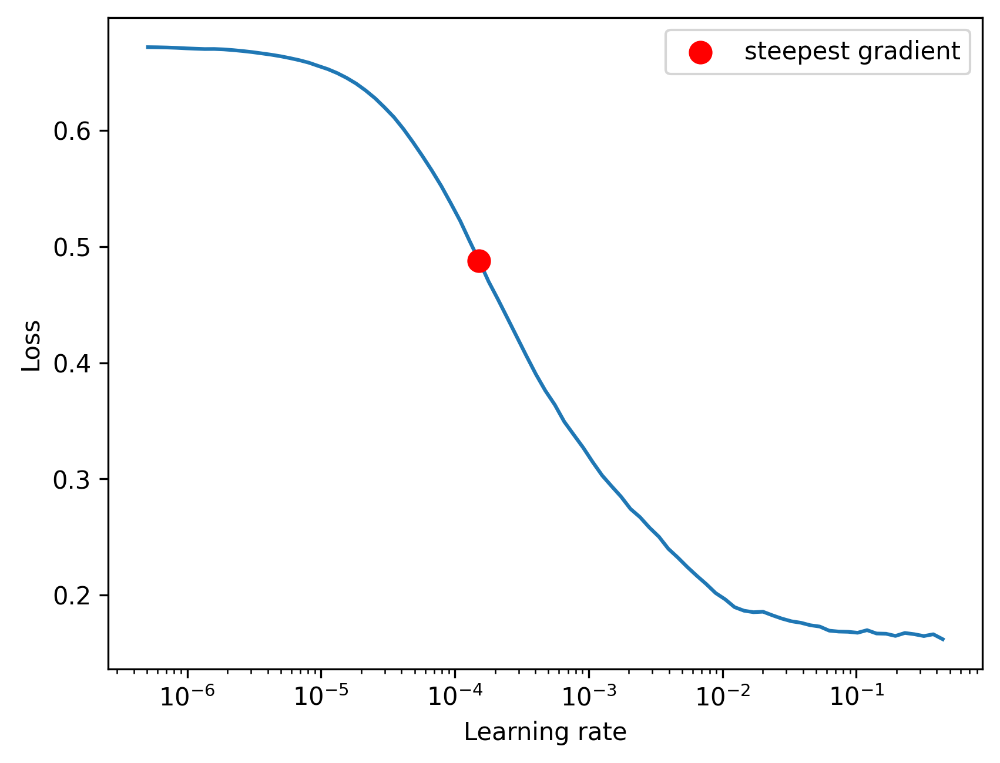

In [ ]:
from torch_lr_finder import LRFinder

device = 'cuda' if torch.cuda.is_available() else 'mps'

model = DualViewResNet()

optimiser = torch.optim.Adam(model.parameters(), lr = 1e-7)
lr_finder = LRFinder(model, optimiser, BCELoss().to(device), device = device)
lr_finder.range_test(train_loader, end_lr=1, num_iter=100)
lr_finder.plot()
lr_finder.reset()

In [ ]:
# Usage
device = torch.device("cuda" if torch.cuda.is_available() else "mps")
model = DualViewResNet(num_classes=15).to(device)
loss_fn = BCELoss().to(device)
net, history = train(model, train_loader, valid_loader, lr=1.52E-04, loss_fn=loss_fn, num_epochs=30, device=device)
history

,Epoch,Train Loss,Valid Loss,Train AP,Valid AP,Time
0,1,0.076303,0.079080,0.245239,0.376635,04:16
1,2,0.052348,0.048142,0.524704,0.667247,04:21
2,3,0.038214,0.055950,0.697286,0.728803,04:19
3,4,0.027376,0.031915,0.832030,0.843150,04:18
4,5,0.020329,0.024337,0.901120,0.885670,04:19
5,6,0.012373,0.035439,0.959249,0.865183,04:19
6,7,0.009150,0.032869,0.976187,0.897287,04:19
7,8,0.006665,0.024748,0.986434,0.910886,04:19
8,9,0.004508,0.028605,0.993878,0.895387,04:18
9,10,0.004421,0.025363,0.994278,0.910037,04:18


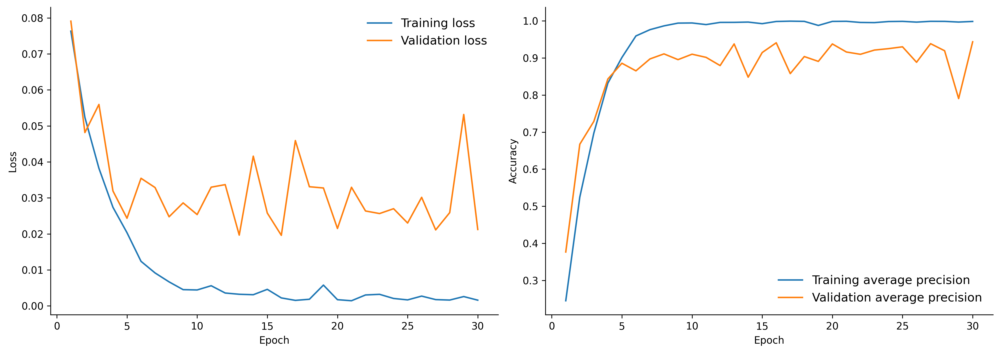

<Figure size 960x720 with 0 Axes>

In [ ]:
import seaborn as sns

fig , axes = plt.subplots(1, 2, figsize=(14, 5), dpi=150)
axes = axes.flatten()

axes[0].plot(history['Epoch'], history['Train Loss'], label = 'Training loss')
axes[0].plot(history['Epoch'], history['Valid Loss'], label = 'Validation loss')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
#axes[0].set_yscale('log')
axes[0].legend(fontsize=12, frameon=False)

axes[1].plot(history['Epoch'], history['Train AP'], label = 'Training average precision')
axes[1].plot(history['Epoch'], history['Valid AP'], label = 'Validation average precision')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(fontsize=12, frameon=False)

sns.despine()

plt.tight_layout()
plt.show()
plt.savefig('history.png', dpi=150)


We could observe that the model has generlised well, and the loss converges. With stable valid average precisions about 91% (average of each's class precisions (TP/FN+TP) in validation data set) after 20 epoches, and final validation AP 92.2%. Consider there are some wrong labels, this is a very good result. Compared to paper's results. Their Vanila(unmodified) ResNet50 has 67% AP, this is likely due to the Network design difference, their Network is a parrell design where each view has its own feature block.

In [ ]:
# save the model
torch.save(net.state_dict(), 'model_trained.pth')
# read the saved model
net_trained = DualViewResNet()
net_trained.load_state_dict(torch.load('model_trained.pth'))
# save the history
history.to_csv('history.csv', index=False)

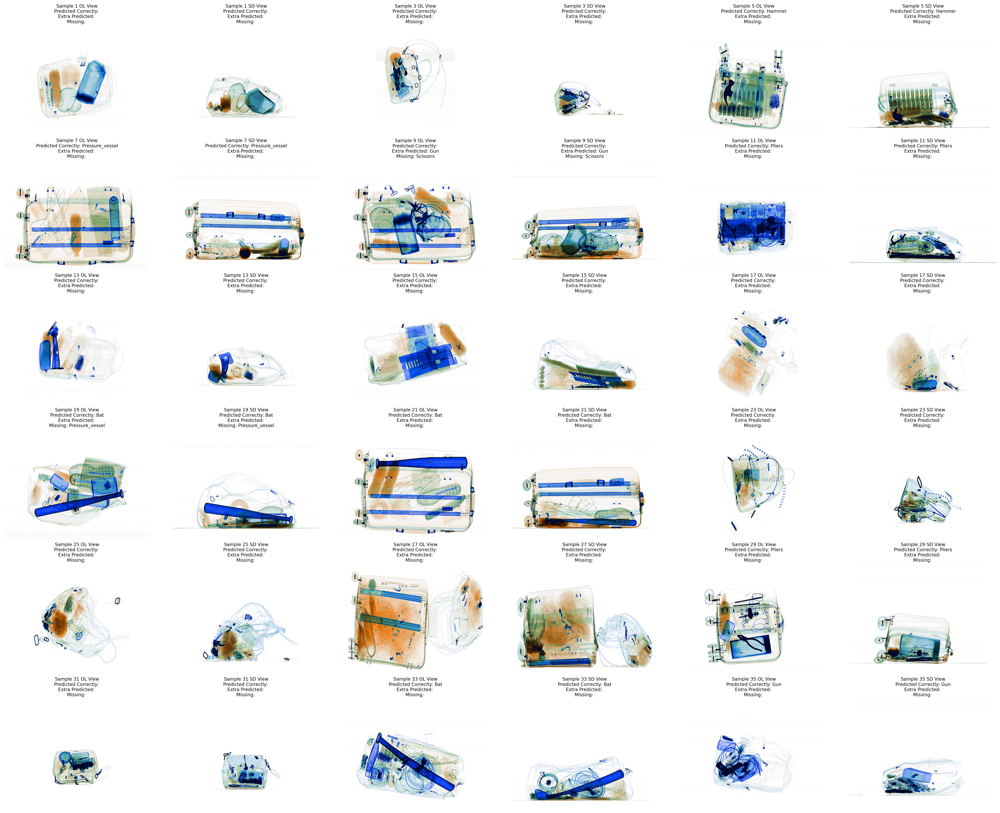

In [ ]:
from torchvision.transforms.functional import to_pil_image

def inverse_normalize(tensor, mean, std):
    """Apply the inverse normalization to a tensor."""
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)  # Multiply by std then add the mean
    return tensor

def show_predictions(net, data, device, prohibited_items, threshold=0.5, shuffle=True):
    mean = (0.91584104, 0.9297611, 0.939562)
    std = (0.22090791, 0.1861283, 0.1651021)
    rows = 6
    cols = 6
    batch_size = rows * cols // 2  # Adjust for two images per item

    dataloader = DataLoader(data, batch_size=batch_size, shuffle=shuffle)
    X, y = next(iter(dataloader))

    X = X.to(device)
    y = y.to(device)

    net.eval()
    with torch.no_grad():
        outputs = net(X)

        predicted_labels = torch.sigmoid(outputs)
        predictions_binary = (predicted_labels > threshold).type(torch.float)

    X = X.cpu()
    predicted_labels = predicted_labels.cpu()
    predictions_binary = predictions_binary.cpu()
    y = y.cpu()

    fig, axes = plt.subplots(rows, cols, figsize=(25, 20), dpi=150)
    axes = axes.flatten()

    for i in range(0, len(axes), 2):
        idx = i // 2
        if idx >= len(X):
            break

        # Apply inverse normalization to both views
        img_ol = inverse_normalize(X[idx][:3].clone(), mean, std)
        img_sd = inverse_normalize(X[idx][3:6].clone(), mean, std)

        img_ol = to_pil_image(img_ol)
        img_sd = to_pil_image(img_sd)

        axes[i].imshow(img_ol)
        axes[i].axis('off')

        axes[i + 1].imshow(img_sd)
        axes[i + 1].axis('off')

        # Labels and predictions
        predicted_indices = torch.where(predictions_binary[idx] == 1)[0]
        true_indices = torch.where(y[idx] == 1)[0]

        predicted_labels_set = {prohibited_items[idx] for idx in predicted_indices}
        true_labels_set = {prohibited_items[idx] for idx in true_indices}

        common_labels = predicted_labels_set.intersection(true_labels_set)
        extra_predicted = predicted_labels_set.difference(true_labels_set)
        missing_true = true_labels_set.difference(predicted_labels_set)

        common_label_text = ', '.join(common_labels)
        extra_predicted_text = ', '.join(extra_predicted)
        missing_true_text = ', '.join(missing_true)

        title_text = f"Predicted Correctly: {common_label_text}\n"
        title_text += f"Extra Predicted: {extra_predicted_text}\n"
        title_text += f"Missing: {missing_true_text}"

        axes[i].set_title(f"Sample {i+1} OL View\n{title_text}", fontsize=8)
        axes[i + 1].set_title(f"Sample {i+1} SD View\n{title_text}", fontsize=8)

    plt.tight_layout()
    plt.show()


show_predictions(model, valid_dataset, device, prohibited_items, shuffle=True)


# Evaluation and Error analysis

In [ ]:
def multi_label_inference(net, loader, device=None):
    # Determine the device to use
    if not device:
        device = 'cuda' if torch.cuda.is_available() else 'cpu'


    net.eval()  # Set model to evaluation mode

    # Number of observations and classes
    num_samples = len(loader.dataset)
    num_classes = 15

    # Initialize arrays to hold the output metrics
    targets = np.zeros((num_samples, num_classes), dtype=int)
    predictions = np.zeros((num_samples, num_classes), dtype=int)
    probabilities = np.zeros((num_samples, num_classes))
    losses = np.zeros(num_samples)

    index = 0

    # Process each batch
    for i, (X, y) in enumerate(loader):
        batch_size = X.shape[0]

        # Move data to the appropriate device
        X = X.to(device)
        y = y.to(device)

        with torch.no_grad():
            # Get model output
            output = net(X)

            # Calculate loss for each sample
            l = F.binary_cross_entropy_with_logits(output, y, reduction='none')
            l = l.mean(dim=1).cpu().numpy()
            losses[index:index + batch_size] = l

            # Predicted probabilities and labels
            y_prob = output.sigmoid().cpu()
            y_hat = (y_prob > 0.5)  # Threshold probabilities to get binary predictions

            probabilities[index:index + batch_size] = y_prob
            predictions[index:index + batch_size] = y_hat
            targets[index:index + batch_size] = y.cpu().numpy()

        index += batch_size

    return targets, predictions, probabilities, losses

targets, predictions, probabilities, losses = multi_label_inference(net, valid_loader)


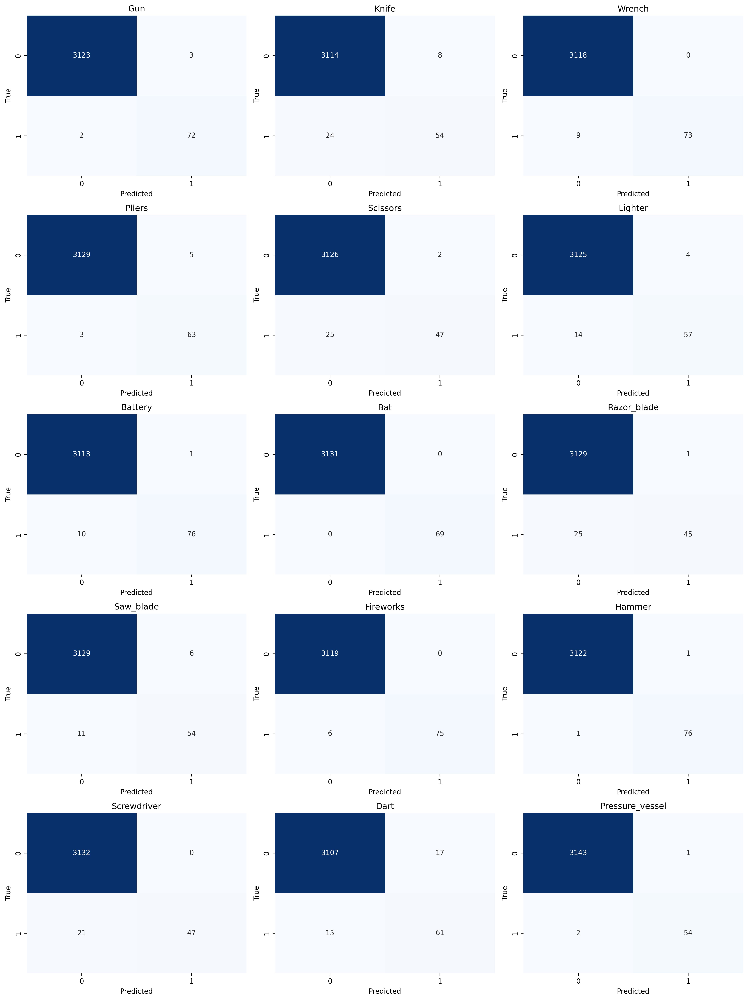

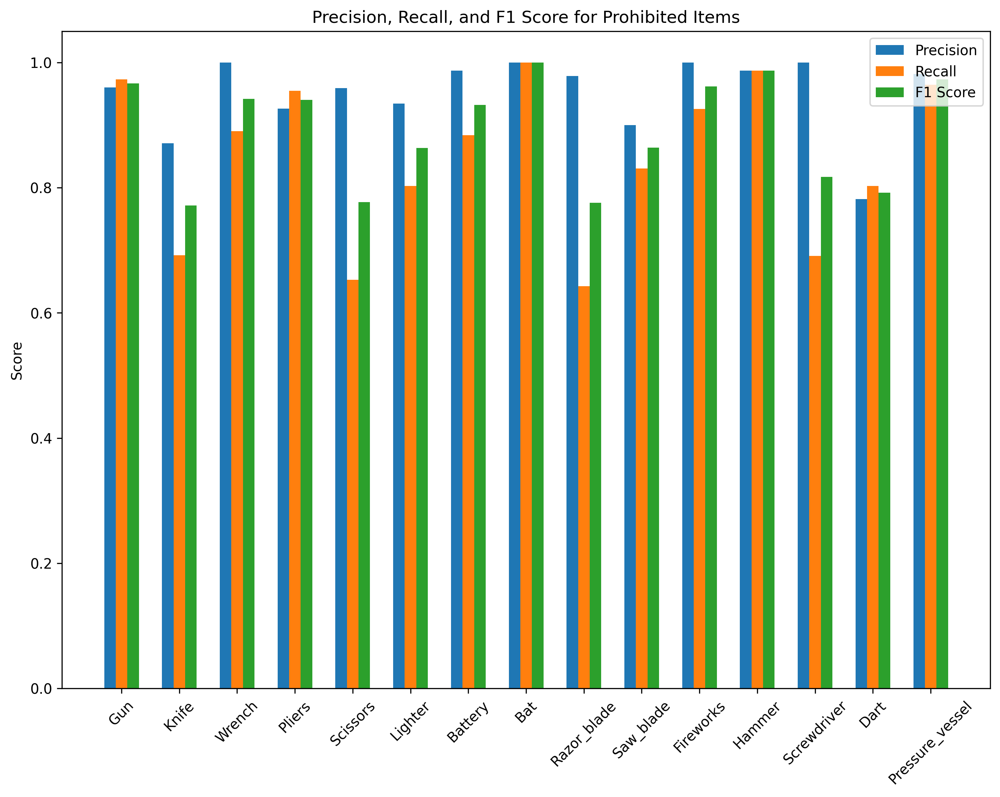

Multi-Label Classification Report
----------------------------------
    Prohibited Item  Precision    Recall  F1 Score
0               Gun   0.960000  0.972973  0.966443
1             Knife   0.870968  0.692308  0.771429
2            Wrench   1.000000  0.890244  0.941935
3            Pliers   0.926471  0.954545  0.940299
4          Scissors   0.959184  0.652778  0.776860
5           Lighter   0.934426  0.802817  0.863636
6           Battery   0.987013  0.883721  0.932515
7               Bat   1.000000  1.000000  1.000000
8       Razor_blade   0.978261  0.642857  0.775862
9         Saw_blade   0.900000  0.830769  0.864000
10        Fireworks   1.000000  0.925926  0.961538
11           Hammer   0.987013  0.987013  0.987013
12      Screwdriver   1.000000  0.691176  0.817391
13             Dart   0.782051  0.802632  0.792208
14  Pressure_vessel   0.981818  0.964286  0.972973

Micro-averaged Precision: 0.9496
Micro-averaged Recall: 0.8460
Micro-averaged F1 Score: 0.8948

Macro-averaged Pre

In [25]:
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support, hamming_loss


def generate_report(targets, predictions, probabilities, prohibited_items, item_to_idx):
    num_classes = len(prohibited_items)

    # Confusion matrix
    confusion_matrices = np.zeros((num_classes, 2, 2), dtype=int)
    for i in range(num_classes):
        confusion_matrices[i] = confusion_matrix(targets[:, i], predictions[:, i])

    # Precision, recall, and F1 score
    precision, recall, f1, _ = precision_recall_fscore_support(targets, predictions, average=None)
    micro_precision, micro_recall, micro_f1, _ = precision_recall_fscore_support(targets, predictions, average='micro')
    macro_precision, macro_recall, macro_f1, _ = precision_recall_fscore_support(targets, predictions, average='macro')

    # Hamming loss
    hamming = hamming_loss(targets, predictions)

    # Subset accuracy
    subset_accuracy = np.mean(np.all(targets == predictions, axis=1))

    # Create a DataFrame for the report
    report_data = {
        'Prohibited Item': prohibited_items,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }
    report_df = pd.DataFrame(report_data)

    # Plot confusion matrices
    fig, axes = plt.subplots(5, 3, figsize=(15, 20))
    axes = axes.ravel()
    for i in range(num_classes):
        sns.heatmap(confusion_matrices[i], annot=True, fmt='d', cmap='Blues', ax=axes[i], cbar=False)
        axes[i].set_title(prohibited_items[i])
        axes[i].set_xlabel('Predicted')
        axes[i].set_ylabel('True')
    plt.tight_layout()
    plt.show()

    # Plot precision, recall, and F1 score
    fig, ax = plt.subplots(figsize=(10, 8))
    x = range(num_classes)
    width = 0.2
    ax.bar(x, precision, width, label='Precision')
    ax.bar([i + width for i in x], recall, width, label='Recall')
    ax.bar([i + 2 * width for i in x], f1, width, label='F1 Score')
    ax.set_xticks([i + width for i in x])
    ax.set_xticklabels(prohibited_items, rotation=45)
    ax.set_ylabel('Score')
    ax.set_title('Precision, Recall, and F1 Score for Prohibited Items')
    ax.legend()
    plt.tight_layout()
    plt.show()

    # Print the report
    print("Multi-Label Classification Report")
    print("----------------------------------")
    print(report_df)
    print("\nMicro-averaged Precision: {:.4f}".format(micro_precision))
    print("Micro-averaged Recall: {:.4f}".format(micro_recall))
    print("Micro-averaged F1 Score: {:.4f}".format(micro_f1))
    print("\nMacro-averaged Precision: {:.4f}".format(macro_precision))
    print("Macro-averaged Recall: {:.4f}".format(macro_recall))
    print("Macro-averaged F1 Score: {:.4f}".format(macro_f1))
    print("\nHamming Loss: {:.4f}".format(hamming))
    print("Subset Accuracy: {:.4f}".format(subset_accuracy))

    return report_df

# Generate the report
net_report = generate_report(targets, predictions, probabilities, prohibited_items, item_to_idx)

Micro-average:

Precision = (Total True Positives) / (Total True Positives + Total False Positives)

Recall = (Total True Positives) / (Total True Positives + Total False Negatives)

F1 score = (2 * Micro-average Precision * Micro-average Recall) / (Micro-average Precision + Micro-average Recall)


Macro-average Precision = (Sum of Precision for each class) / (Number of classes)

Macro-average Recall = (Sum of Recall for each class) / (Number of classes)

Macro-average F1 score = (Sum of F1 score for each class) / (Number of classes)

Subset Accuracy:

Subset accuracy measures the proportion of samples where all the predicted labels exactly match the true labels.
It is a strict metric that requires the predicted label set to be an exact match of the true label set for each sample.
Subset accuracy is calculated as: (Number of samples with exactly matching labels) / (Total number of samples)
It is a challenging metric to achieve high scores on, especially when the number of labels is large.

Precision for a single label is defined as: (True Positives) / (True Positives + False Positives)

Recall for a single label is defined as: (True Positives) / (True Positives + False Negatives)

The F1 score is the harmonic mean of precision and recall.
It provides a balanced measure that combines both precision and recall.
F1 score for a single label is defined as: (2 * Precision * Recall) / (Precision + Recall)

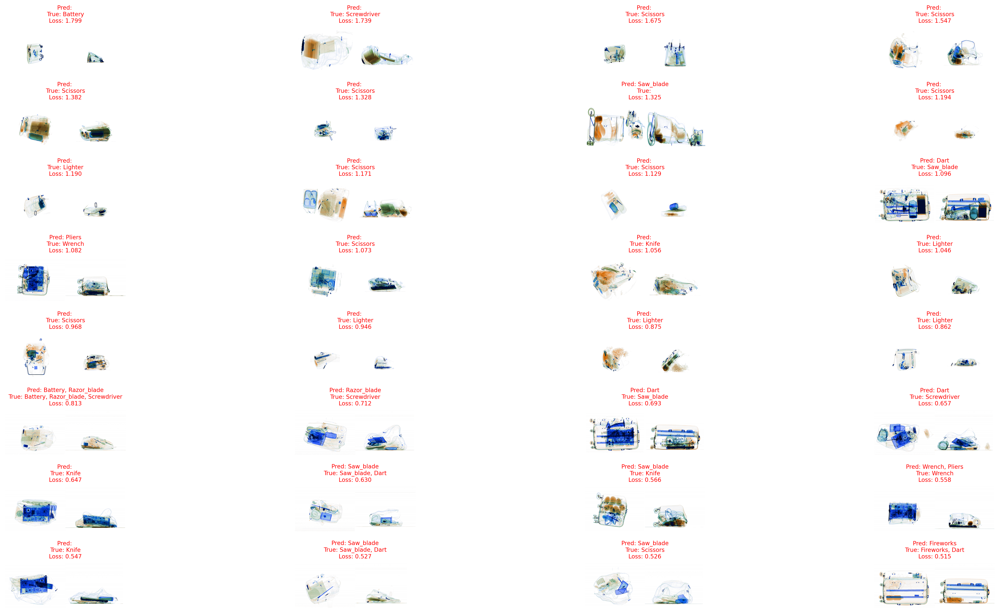

array([<Axes: title={'center': 'Pred: \nTrue: Battery\nLoss: 1.799'}>,
       <Axes: title={'center': 'Pred: \nTrue: Screwdriver\nLoss: 1.739'}>,
       <Axes: title={'center': 'Pred: \nTrue: Scissors\nLoss: 1.675'}>,
       <Axes: title={'center': 'Pred: \nTrue: Scissors\nLoss: 1.547'}>,
       <Axes: title={'center': 'Pred: \nTrue: Scissors\nLoss: 1.382'}>,
       <Axes: title={'center': 'Pred: \nTrue: Scissors\nLoss: 1.328'}>,
       <Axes: title={'center': 'Pred: Saw_blade\nTrue: \nLoss: 1.325'}>,
       <Axes: title={'center': 'Pred: \nTrue: Scissors\nLoss: 1.194'}>,
       <Axes: title={'center': 'Pred: \nTrue: Lighter\nLoss: 1.190'}>,
       <Axes: title={'center': 'Pred: \nTrue: Scissors\nLoss: 1.171'}>,
       <Axes: title={'center': 'Pred: \nTrue: Scissors\nLoss: 1.129'}>,
       <Axes: title={'center': 'Pred: Dart\nTrue: Saw_blade\nLoss: 1.096'}>,
       <Axes: title={'center': 'Pred: Pliers\nTrue: Wrench\nLoss: 1.082'}>,
       <Axes: title={'center': 'Pred: \nTrue: Scissor

In [ ]:
def plot_large_error_sample(data, targets, preds, probs, losses, prohibited_items, mean, std):
    rows = 8
    cols = 4
    batch_size = rows * cols

    # Get indices for the largest losses
    indexes = np.flip(np.argsort(losses)[-batch_size:])

    # Prepare figure
    fig, axes = plt.subplots(rows, cols, figsize=(24, 12))
    axes = axes.flatten()

    for j, (ax, i) in enumerate(zip(axes, indexes)):
        image, _ = data[i]  # Assuming data is a list of tuples (image, label)
        image_ol = image[:3]
        image_sd = image[3:]
        img_ol = image_ol.numpy()
        img_sd = image_sd.numpy()

        # Reverse standardization for overlaid view
        img_ol[0, :, :] = mean[0] + std[0] * img_ol[0, :, :]
        img_ol[1, :, :] = mean[1] + std[1] * img_ol[1, :, :]
        img_ol[2, :, :] = mean[2] + std[2] * img_ol[2, :, :]

        # Reverse standardization for side-by-side view
        img_sd[0, :, :] = mean[0] + std[0] * img_sd[0, :, :]
        img_sd[1, :, :] = mean[1] + std[1] * img_sd[1, :, :]
        img_sd[2, :, :] = mean[2] + std[2] * img_sd[2, :, :]

        # Each pixel needs to have a value between 0 and 1
        img_ol[img_ol < 0] = 0
        img_ol[img_ol > 1] = 1
        img_sd[img_sd < 0] = 0
        img_sd[img_sd > 1] = 1

        # Show overlaid and side-by-side images side by side
        ax.imshow(np.hstack((np.transpose(img_ol, (1, 2, 0)), np.transpose(img_sd, (1, 2, 0)))))
        ax.axis('off')

        # Get predicted and true labels
        pred_labels = [prohibited_items[k] for k in np.where(preds[i] == 1)[0]]
        true_labels = [prohibited_items[k] for k in np.where(targets[i] == 1)[0]]

        # Set title based on prediction correctness
        if np.array_equal(targets[i], preds[i]):
            ax.set_title(f"Pred: {', '.join(pred_labels)}\nLoss: {losses[i]:.3f}", color='green', fontsize=8)
        else:
            ax.set_title(f"Pred: {', '.join(pred_labels)}\nTrue: {', '.join(true_labels)}\nLoss: {losses[i]:.3f}", color='red', fontsize=8)
    plt.subplots_adjust(hspace=0.2, wspace=0.2)
    plt.tight_layout()
    plt.show()

    return axes

# Normalization parameters
mean = (0.91584104, 0.9297611, 0.939562)
std = (0.22090791, 0.1861283, 0.1651021)

plot_large_error_sample(valid_dataset, targets, predictions, probabilities, losses, prohibited_items, mean, std)